# Predicción de Demanda Energética con Forecasting Recursivo Multi-Step

Este notebook implementa un método de forecasting recursivo multi-step para predecir la demanda energética del día siguiente utilizando la clase `ForecasterRecursive` de skforecast.

## Descripción del Método

**Forecasting multi-step recursivo**: Este método consiste en utilizar las propias predicciones del modelo como valores de entrada para predecir el siguiente valor. Por ejemplo, para predecir los 5 valores siguientes de una serie temporal, se entrena un modelo para predecir el siguiente valor (t+1), y se utiliza este valor para predecir el siguiente (t+2), y así sucesivamente. Todo este proceso se automatiza con la clase `ForecasterRecursive`.

## Estructura del Notebook

1. **Carga y procesamiento de datos**
2. **Análisis exploratorio**
3. **Partición de datos (train/validation/test)**
4. **Implementación del modelo recursivo**
5. **Evaluación y visualización**
6. **Predicción del día siguiente**


In [16]:
# ==============================================================================
# IMPORTACIÓN DE LIBRERÍAS
# ==============================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# Forecasting y machine learning
from skforecast.recursive import ForecasterRecursive
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster
from skforecast.preprocessing import RollingFeatures
from skforecast.plot import plot_residuals
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Configuración de visualización
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams.update({'font.size': 10})
sns.set_palette("husl")

print("✅ Librerías importadas correctamente")
print(f"📊 Pandas version: {pd.__version__}")
print(f"🔮 Skforecast disponible")
print(f"🌳 LightGBM disponible")


✅ Librerías importadas correctamente
📊 Pandas version: 2.3.2
🔮 Skforecast disponible
🌳 LightGBM disponible


## 1. Carga y Procesamiento de Datos

Cargamos los datos de demanda energética desde los archivos Excel y los procesamos para crear una serie temporal completa.


In [17]:
def load_energy_data():
    """
    Carga y procesa los datos de demanda energética desde múltiples archivos Excel
    """
    import os
    import glob
    
    print("🔄 Cargando datos de demanda energética...")
    
    # Buscar archivos Excel en la carpeta demanda-energia-sin/
    data_folder = 'demanda-energia-sin'
    if not os.path.exists(data_folder):
        raise FileNotFoundError(f"No se encontró la carpeta '{data_folder}'")
    
    excel_files = glob.glob(os.path.join(data_folder, '*.xlsx'))
    excel_files.sort()
    
    if not excel_files:
        raise FileNotFoundError(f"No se encontraron archivos Excel en la carpeta '{data_folder}'")
    
    print(f"📁 Encontrados {len(excel_files)} archivos Excel")
    
    # Cargar y combinar todos los archivos
    all_data = []
    
    for file_path in excel_files:
        try:
            # Leer archivo Excel con header en la fila 3
            df = pd.read_excel(file_path, header=3)
            
            # Extraer año del nombre del archivo
            year = os.path.basename(file_path).split('_')[-1].replace('.xlsx', '')
            df['year'] = int(year)
            
            all_data.append(df)
            print(f"  ✅ {os.path.basename(file_path)}: {df.shape[0]} registros")
            
        except Exception as e:
            print(f"  ❌ Error en {os.path.basename(file_path)}: {e}")
            continue
    
    if not all_data:
        raise ValueError("No se pudieron cargar archivos Excel válidos")
    
    # Combinar todos los datos
    datos = pd.concat(all_data, ignore_index=True)
    print(f"📊 Dataset combinado: {datos.shape}")
    
    return datos

# Cargar los datos
datos_raw = load_energy_data()
print(f"\n📋 Columnas disponibles: {list(datos_raw.columns)}")
print(f"📅 Rango de años: {datos_raw['year'].min()} - {datos_raw['year'].max()}")


🔄 Cargando datos de demanda energética...
📁 Encontrados 24 archivos Excel
  ✅ Demanda_Energia_SIN_2000.xlsx: 366 registros
  ✅ Demanda_Energia_SIN_2001.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2002.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2003.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2004.xlsx: 366 registros
  ✅ Demanda_Energia_SIN_2005.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2006.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2007.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2008.xlsx: 366 registros
  ✅ Demanda_Energia_SIN_2009.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2010.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2013.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2014.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2015.xlsx: 364 registros
  ✅ Demanda_Energia_SIN_2016.xlsx: 366 registros
  ✅ Demanda_Energia_SIN_2017.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2018.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2019.xlsx: 365 registros
  ✅ Demanda_Energia_SIN_2020.xlsx: 366 regis

In [18]:
def preprocess_data(datos_raw):
    """
    Procesa los datos para crear una serie temporal de demanda energética
    """
    print("🔄 Procesando datos...")
    
    # Detectar columnas de fecha y demanda automáticamente
    date_columns = []
    demand_columns = []
    
    for col in datos_raw.columns:
        col_lower = col.lower()
        if any(keyword in col_lower for keyword in ['fecha', 'date', 'time', 'tiempo']):
            date_columns.append(col)
        if any(keyword in col_lower for keyword in ['demanda', 'demand', 'consumo', 'consumption', 'energia', 'energy']):
            demand_columns.append(col)
    
    print(f"📅 Columnas de fecha detectadas: {date_columns}")
    print(f"⚡ Columnas de demanda detectadas: {demand_columns}")
    
    if not date_columns or not demand_columns:
        raise ValueError("No se detectaron columnas de fecha o demanda")
    
    # Usar las primeras columnas encontradas
    date_col = date_columns[0]
    demand_col = demand_columns[0]
    
    # Preparar datos
    datos = datos_raw[[date_col, demand_col]].copy()
    datos.columns = ['Time', 'Demand']
    
    # Convertir fecha y limpiar datos
    datos['Time'] = pd.to_datetime(datos['Time'], errors='coerce')
    datos = datos.dropna()
    datos = datos.set_index('Time')
    datos = datos.sort_index()
    
    # Crear datos horarios si son diarios
    freq_detected = pd.infer_freq(datos.index)
    print(f"🕐 Frecuencia detectada: {freq_detected}")
    
    if freq_detected is None or freq_detected == 'D':
        print("📅 Datos diarios detectados. Creando datos horarios simulados...")
        datos_horarios = []
        
        for fecha, row in datos.iterrows():
            for hora in range(24):
                # Patrón diario típico de demanda eléctrica
                if 8 <= hora <= 10 or 18 <= hora <= 20:  # Picos
                    factor = 1.2 + 0.3 * np.sin(2 * np.pi * hora / 24)
                elif 22 <= hora or hora <= 6:  # Valle nocturno
                    factor = 0.6 + 0.2 * np.sin(2 * np.pi * hora / 24)
                else:  # Base
                    factor = 0.8 + 0.2 * np.sin(2 * np.pi * hora / 24)
                
                # Agregar variabilidad aleatoria
                factor += np.random.normal(0, 0.1)
                factor = max(0.3, factor)
                
                demanda_horaria = row['Demand'] * factor / 24
                fecha_hora = pd.Timestamp(fecha.year, fecha.month, fecha.day, hora)
                
                datos_horarios.append({
                    'Time': fecha_hora,
                    'Demand': demanda_horaria
                })
        
        datos = pd.DataFrame(datos_horarios)
        datos = datos.set_index('Time')
        datos = datos.sort_index()
        datos = datos.asfreq("H")
    
    # Limpiar valores faltantes
    if datos['Demand'].isnull().sum() > 0:
        print("🔧 Interpolando valores faltantes...")
        datos['Demand'] = datos['Demand'].interpolate(method='linear')
    
    print(f"✅ Datos procesados: {datos.shape}")
    print(f"📅 Rango temporal: {datos.index.min()} a {datos.index.max()}")
    
    return datos

# Procesar los datos
datos = preprocess_data(datos_raw)
print(f"\n📊 Estadísticas de demanda:")
print(datos['Demand'].describe())


🔄 Procesando datos...
📅 Columnas de fecha detectadas: ['Fecha']
⚡ Columnas de demanda detectadas: ['Demanda Energia SIN kWh', 'Demanda No Atendida kWh']
🕐 Frecuencia detectada: None
📅 Datos diarios detectados. Creando datos horarios simulados...
🔧 Interpolando valores faltantes...
✅ Datos procesados: (225336, 1)
📅 Rango temporal: 2000-01-01 00:00:00 a 2025-09-14 23:00:00

📊 Estadísticas de demanda:
count    2.253360e+05
mean     5.515057e+06
std      2.318179e+06
min      5.030090e+02
25%      3.780324e+06
50%      5.049280e+06
75%      6.659924e+06
max      1.810248e+07
Name: Demand, dtype: float64


## 2. Análisis Exploratorio de Datos

Realizamos un análisis exploratorio para entender los patrones en la serie temporal de demanda energética.


📊 ANÁLISIS EXPLORATORIO
📅 Período: 2000-01-01 00:00:00 a 2025-09-14 23:00:00
⏱️  Duración: 9388 días
📈 Total observaciones: 225,336
🕐 Frecuencia: h

📊 Estadísticas de demanda:
count    2.253360e+05
mean     5.515057e+06
std      2.318179e+06
min      5.030090e+02
25%      3.780324e+06
50%      5.049280e+06
75%      6.659924e+06
max      1.810248e+07
Name: Demand, dtype: float64


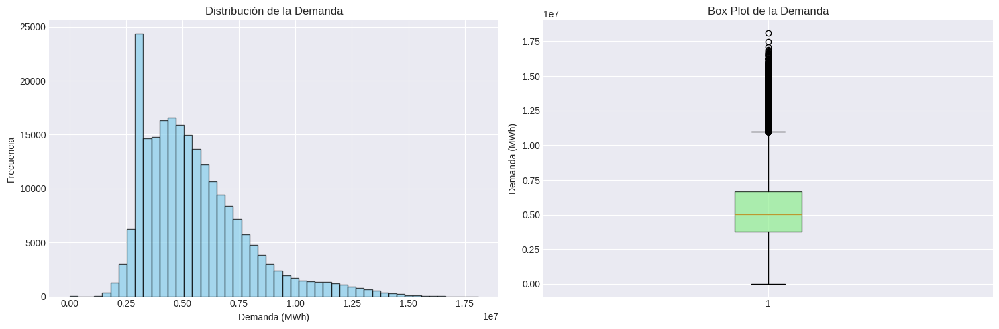

In [19]:
def exploratory_analysis(datos):
    """
    Realiza análisis exploratorio de la serie temporal
    """
    print("📊 ANÁLISIS EXPLORATORIO")
    print("=" * 50)
    
    # Estadísticas básicas
    print(f"📅 Período: {datos.index.min()} a {datos.index.max()}")
    print(f"⏱️  Duración: {(datos.index.max() - datos.index.min()).days} días")
    print(f"📈 Total observaciones: {len(datos):,}")
    print(f"🕐 Frecuencia: {pd.infer_freq(datos.index)}")
    
    # Estadísticas de demanda
    print(f"\n📊 Estadísticas de demanda:")
    stats = datos['Demand'].describe()
    print(stats)
    
    # Gráfico de la serie temporal completa
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=datos.index, 
        y=datos['Demand'], 
        mode='lines', 
        name='Demanda Energética',
        line=dict(color='blue', width=1)
    ))
    
    fig.update_layout(
        title='Serie Temporal de Demanda Energética',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=400
    )
    fig.show()
    
    # Gráfico de distribución
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Histograma
    ax1.hist(datos['Demand'], bins=50, alpha=0.7, color='skyblue', edgecolor='black')
    ax1.set_title('Distribución de la Demanda')
    ax1.set_xlabel('Demanda (MWh)')
    ax1.set_ylabel('Frecuencia')
    
    # Box plot
    ax2.boxplot(datos['Demand'], patch_artist=True, 
                boxprops=dict(facecolor='lightgreen', alpha=0.7))
    ax2.set_title('Box Plot de la Demanda')
    ax2.set_ylabel('Demanda (MWh)')
    
    plt.tight_layout()
    plt.show()
    
    return stats

# Realizar análisis exploratorio
stats_demanda = exploratory_analysis(datos)


## 3. Partición de Datos (Train/Validation/Test)

Dividimos los datos en tres conjuntos siguiendo buenas prácticas de machine learning para series temporales.


In [20]:
def split_data(datos, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    """
    Divide los datos en conjuntos de entrenamiento, validación y prueba
    """
    print("🔄 Dividiendo datos en train/validation/test...")
    
    # Verificar que las proporciones sumen 1
    assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 1e-6, "Las proporciones deben sumar 1"
    
    total_len = len(datos)
    train_len = int(total_len * train_ratio)
    val_len = int(total_len * val_ratio)
    
    # Dividir los datos
    datos_train = datos.iloc[:train_len].copy()
    datos_val = datos.iloc[train_len:train_len + val_len].copy()
    datos_test = datos.iloc[train_len + val_len:].copy()
    
    # Obtener fechas de corte
    fin_train = datos_train.index[-1]
    fin_validacion = datos_val.index[-1]
    
    print(f"📊 División de datos:")
    print(f"  🟦 Entrenamiento: {datos_train.index.min().date()} - {datos_train.index.max().date()} ({len(datos_train):,} obs)")
    print(f"  🟧 Validación:    {datos_val.index.min().date()} - {datos_val.index.max().date()} ({len(datos_val):,} obs)")
    print(f"  🟥 Prueba:        {datos_test.index.min().date()} - {datos_test.index.max().date()} ({len(datos_test):,} obs)")
    
    # Visualizar la división
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=datos_train.index, 
        y=datos_train['Demand'], 
        mode='lines', 
        name='Entrenamiento',
        line=dict(color='blue', width=1)
    ))
    
    fig.add_trace(go.Scatter(
        x=datos_val.index, 
        y=datos_val['Demand'], 
        mode='lines', 
        name='Validación',
        line=dict(color='orange', width=1)
    ))
    
    fig.add_trace(go.Scatter(
        x=datos_test.index, 
        y=datos_test['Demand'], 
        mode='lines', 
        name='Prueba',
        line=dict(color='red', width=1)
    ))
    
    # Agregar líneas verticales para mostrar los cortes
    fig.add_shape(
        type="line",
        x0=fin_train, x1=fin_train,
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    fig.add_shape(
        type="line",
        x0=fin_validacion, x1=fin_validacion,
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    
    # Agregar anotaciones para las líneas
    fig.add_annotation(
        x=fin_train,
        y=0.95,
        yref="paper",
        text="Fin Train",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    fig.add_annotation(
        x=fin_validacion,
        y=0.95,
        yref="paper",
        text="Fin Val",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    
    fig.update_layout(
        title='División de Datos en Train/Validation/Test',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=500,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    fig.show()
    
    return datos_train, datos_val, datos_test, fin_train, fin_validacion

# Dividir los datos
datos_train, datos_val, datos_test, fin_train, fin_validacion = split_data(datos)


🔄 Dividiendo datos en train/validation/test...
📊 División de datos:
  🟦 Entrenamiento: 2000-01-01 - 2017-12-29 (157,735 obs)
  🟧 Validación:    2017-12-29 - 2021-11-06 (33,800 obs)
  🟥 Prueba:        2021-11-06 - 2025-09-14 (33,801 obs)


## 4. Implementación del Modelo Recursivo Multi-Step

Implementamos el modelo de forecasting recursivo utilizando `ForecasterRecursive` de skforecast con LightGBM como regresor.


In [21]:
def create_recursive_forecaster():
    """
    Crea un forecaster recursivo multi-step con LightGBM
    """
    print("🔮 Creando modelo de forecasting recursivo...")
    
    # Configurar el regresor LightGBM
    regressor = LGBMRegressor(
        n_estimators=100,
        max_depth=6,
        learning_rate=0.1,
        random_state=42,
        verbose=-1
    )
    
    # Crear features de ventana deslizante
    window_features = RollingFeatures(
        stats=["mean", "std"], 
        window_sizes=[24, 24*7]  # 24 horas y 7 días
    )
    
    # Crear el forecaster recursivo
    forecaster = ForecasterRecursive(
        regressor=regressor,
        lags=24,  # Usar las últimas 24 horas como predictores
        window_features=window_features
    )
    
    print("✅ Forecaster recursivo creado")
    print(f"  📊 Regresor: LightGBM")
    print(f"  ⏰ Lags: 24 horas")
    print(f"  🪟 Ventanas: 24h y 7 días")
    
    return forecaster

# Crear el forecaster
forecaster = create_recursive_forecaster()


🔮 Creando modelo de forecasting recursivo...
✅ Forecaster recursivo creado
  📊 Regresor: LightGBM
  ⏰ Lags: 24 horas
  🪟 Ventanas: 24h y 7 días


In [22]:
def train_and_evaluate_model(forecaster, datos_train, datos_val, datos_test):
    """
    Entrena el modelo y evalúa su rendimiento
    """
    print("🚀 Entrenando modelo...")
    
    # Entrenar el modelo con datos de entrenamiento
    forecaster.fit(y=datos_train['Demand'])
    print("✅ Modelo entrenado")
    
    # Realizar predicciones en el conjunto de validación
    print("🔮 Realizando predicciones en validación...")
    predicciones_val = forecaster.predict(steps=len(datos_val))
    
    # Realizar predicciones en el conjunto de prueba
    print("🔮 Realizando predicciones en prueba...")
    predicciones_test = forecaster.predict(steps=len(datos_test))
    
    # Calcular métricas de evaluación
    def calculate_metrics(y_true, y_pred, dataset_name):
        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_true, y_pred)
        
        print(f"\n📊 Métricas - {dataset_name}:")
        print(f"  MAE:  {mae:.2f}")
        print(f"  MSE:  {mse:.2f}")
        print(f"  RMSE: {rmse:.2f}")
        print(f"  R²:   {r2:.4f}")
        
        return {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'R2': r2}
    
    # Evaluar en validación
    metrics_val = calculate_metrics(datos_val['Demand'], predicciones_val, "Validación")
    
    # Evaluar en prueba
    metrics_test = calculate_metrics(datos_test['Demand'], predicciones_test, "Prueba")
    
    return predicciones_val, predicciones_test, metrics_val, metrics_test

# Entrenar y evaluar el modelo
predicciones_val, predicciones_test, metrics_val, metrics_test = train_and_evaluate_model(
    forecaster, datos_train, datos_val, datos_test
)


🚀 Entrenando modelo...
✅ Modelo entrenado
🔮 Realizando predicciones en validación...
🔮 Realizando predicciones en prueba...

📊 Métricas - Validación:
  MAE:  2801070.22
  MSE:  9473484865059.07
  RMSE: 3077902.67
  R²:   -0.8627

📊 Métricas - Prueba:
  MAE:  3846569.27
  MSE:  22665834180619.18
  RMSE: 4760864.86
  R²:   -2.4862


## 5. Visualización de Resultados

Creamos gráficos de dispersión y comparaciones para evaluar el rendimiento del modelo.


📊 Creando gráficos de dispersión...


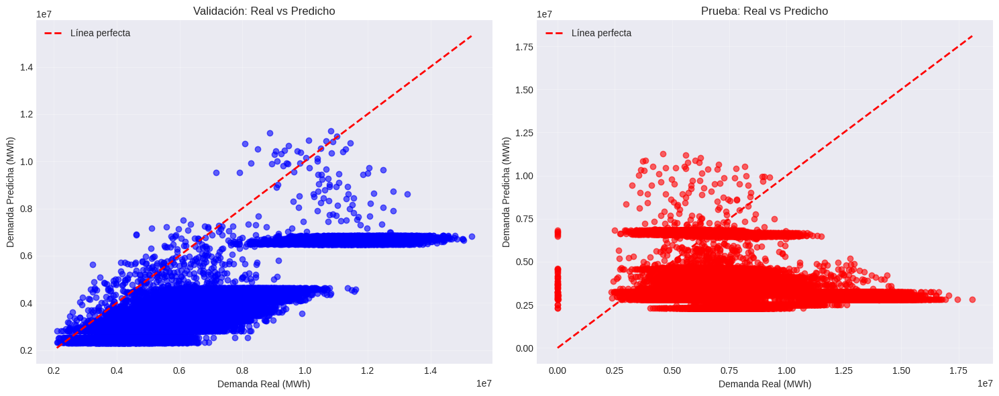

In [23]:
def create_scatter_plots(datos_val, predicciones_val, datos_test, predicciones_test):
    """
    Crea gráficos de dispersión para comparar valores reales vs predichos
    """
    print("📊 Creando gráficos de dispersión...")
    
    # Crear subplots
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Gráfico de dispersión para validación
    axes[0].scatter(datos_val['Demand'], predicciones_val, alpha=0.6, color='blue')
    axes[0].plot([datos_val['Demand'].min(), datos_val['Demand'].max()], 
                 [datos_val['Demand'].min(), datos_val['Demand'].max()], 
                 'r--', lw=2, label='Línea perfecta')
    axes[0].set_xlabel('Demanda Real (MWh)')
    axes[0].set_ylabel('Demanda Predicha (MWh)')
    axes[0].set_title('Validación: Real vs Predicho')
    axes[0].legend()
    axes[0].grid(True, alpha=0.3)
    
    # Gráfico de dispersión para prueba
    axes[1].scatter(datos_test['Demand'], predicciones_test, alpha=0.6, color='red')
    axes[1].plot([datos_test['Demand'].min(), datos_test['Demand'].max()], 
                 [datos_test['Demand'].min(), datos_test['Demand'].max()], 
                 'r--', lw=2, label='Línea perfecta')
    axes[1].set_xlabel('Demanda Real (MWh)')
    axes[1].set_ylabel('Demanda Predicha (MWh)')
    axes[1].set_title('Prueba: Real vs Predicho')
    axes[1].legend()
    axes[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Crear gráfico interactivo con Plotly
    fig = make_subplots(
        rows=1, cols=2,
        subplot_titles=('Validación: Real vs Predicho', 'Prueba: Real vs Predicho'),
        horizontal_spacing=0.1
    )
    
    # Validación
    fig.add_trace(
        go.Scatter(
            x=datos_val['Demand'],
            y=predicciones_val,
            mode='markers',
            name='Validación',
            marker=dict(color='blue', opacity=0.6),
            hovertemplate='Real: %{x:.2f}<br>Predicho: %{y:.2f}<extra></extra>'
        ),
        row=1, col=1
    )
    
    # Línea perfecta para validación
    min_val = min(datos_val['Demand'].min(), predicciones_val.min())
    max_val = max(datos_val['Demand'].max(), predicciones_val.max())
    fig.add_trace(
        go.Scatter(
            x=[min_val, max_val],
            y=[min_val, max_val],
            mode='lines',
            name='Línea perfecta',
            line=dict(dash='dash', color='red'),
            showlegend=False
        ),
        row=1, col=1
    )
    
    # Prueba
    fig.add_trace(
        go.Scatter(
            x=datos_test['Demand'],
            y=predicciones_test,
            mode='markers',
            name='Prueba',
            marker=dict(color='red', opacity=0.6),
            hovertemplate='Real: %{x:.2f}<br>Predicho: %{y:.2f}<extra></extra>'
        ),
        row=1, col=2
    )
    
    # Línea perfecta para prueba
    min_test = min(datos_test['Demand'].min(), predicciones_test.min())
    max_test = max(datos_test['Demand'].max(), predicciones_test.max())
    fig.add_trace(
        go.Scatter(
            x=[min_test, max_test],
            y=[min_test, max_test],
            mode='lines',
            name='Línea perfecta',
            line=dict(dash='dash', color='red'),
            showlegend=False
        ),
        row=1, col=2
    )
    
    fig.update_layout(
        title='Gráficos de Dispersión: Demanda Real vs Predicha',
        height=500,
        showlegend=True
    )
    
    fig.update_xaxes(title_text="Demanda Real (MWh)", row=1, col=1)
    fig.update_xaxes(title_text="Demanda Real (MWh)", row=1, col=2)
    fig.update_yaxes(title_text="Demanda Predicha (MWh)", row=1, col=1)
    fig.update_yaxes(title_text="Demanda Predicha (MWh)", row=1, col=2)
    
    fig.show()

# Crear gráficos de dispersión
create_scatter_plots(datos_val, predicciones_val, datos_test, predicciones_test)


In [24]:
def create_time_series_plots(datos_train, datos_val, datos_test, predicciones_val, predicciones_test):
    """
    Crea gráficos de series temporales mostrando las predicciones
    """
    print("📈 Creando gráficos de series temporales...")
    
    # Crear gráfico con Plotly
    fig = go.Figure()
    
    # Datos de entrenamiento
    fig.add_trace(go.Scatter(
        x=datos_train.index,
        y=datos_train['Demand'],
        mode='lines',
        name='Entrenamiento',
        line=dict(color='blue', width=1)
    ))
    
    # Datos reales de validación
    fig.add_trace(go.Scatter(
        x=datos_val.index,
        y=datos_val['Demand'],
        mode='lines',
        name='Validación (Real)',
        line=dict(color='orange', width=1)
    ))
    
    # Predicciones de validación
    fig.add_trace(go.Scatter(
        x=datos_val.index,
        y=predicciones_val,
        mode='lines',
        name='Validación (Predicho)',
        line=dict(color='orange', width=2, dash='dash')
    ))
    
    # Datos reales de prueba
    fig.add_trace(go.Scatter(
        x=datos_test.index,
        y=datos_test['Demand'],
        mode='lines',
        name='Prueba (Real)',
        line=dict(color='red', width=1)
    ))
    
    # Predicciones de prueba
    fig.add_trace(go.Scatter(
        x=datos_test.index,
        y=predicciones_test,
        mode='lines',
        name='Prueba (Predicho)',
        line=dict(color='red', width=2, dash='dash')
    ))
    
    fig.update_layout(
        title='Serie Temporal: Demanda Real vs Predicha',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1200,
        height=600,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    
    fig.show()
    
    # Crear gráfico de zoom en los últimos datos
    fig_zoom = go.Figure()
    
    # Últimos 7 días de datos
    ultimos_7_dias = datos_test.tail(7*24)
    predicciones_7_dias = predicciones_test.tail(7*24)
    
    fig_zoom.add_trace(go.Scatter(
        x=ultimos_7_dias.index,
        y=ultimos_7_dias['Demand'],
        mode='lines',
        name='Real (Últimos 7 días)',
        line=dict(color='red', width=2)
    ))
    
    fig_zoom.add_trace(go.Scatter(
        x=ultimos_7_dias.index,
        y=predicciones_7_dias,
        mode='lines',
        name='Predicho (Últimos 7 días)',
        line=dict(color='blue', width=2, dash='dash')
    ))
    
    fig_zoom.update_layout(
        title='Zoom: Últimos 7 Días - Real vs Predicho',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=400
    )
    
    fig_zoom.show()

# Crear gráficos de series temporales
create_time_series_plots(datos_train, datos_val, datos_test, predicciones_val, predicciones_test)


📈 Creando gráficos de series temporales...


## 6. Predicción del Día Siguiente

Finalmente, utilizamos el modelo entrenado para predecir la demanda energética del día siguiente a la última fecha disponible en los datos.


In [25]:
def predict_next_day(forecaster, datos):
    """
    Predice la demanda energética para el día siguiente
    """
    print("🔮 PREDICCIÓN DEL DÍA SIGUIENTE")
    print("=" * 50)
    
    # Obtener la última fecha de los datos
    ultima_fecha = datos.index.max()
    print(f"📅 Última fecha en los datos: {ultima_fecha}")
    
    # Calcular la fecha del día siguiente
    siguiente_dia = ultima_fecha + pd.Timedelta(days=1)
    print(f"🎯 Prediciendo demanda para: {siguiente_dia.date()}")
    
    # Crear fechas para las 24 horas del día siguiente
    horas_siguiente_dia = pd.date_range(
        start=siguiente_dia.replace(hour=0, minute=0, second=0),
        end=siguiente_dia.replace(hour=23, minute=0, second=0),
        freq='H'
    )
    
    print(f"⏰ Horas a predecir: {len(horas_siguiente_dia)} (24 horas)")
    
    # Realizar la predicción para las 24 horas del día siguiente
    prediccion_siguiente = forecaster.predict(steps=24)
    
    # Crear DataFrame con las predicciones
    prediccion_df = pd.DataFrame({
        'fecha_hora': horas_siguiente_dia,
        'demanda_predicha': prediccion_siguiente
    })
    
    # Calcular estadísticas de la predicción
    demanda_total_dia = prediccion_siguiente.sum()
    demanda_promedio = prediccion_siguiente.mean()
    demanda_maxima = prediccion_siguiente.max()
    demanda_minima = prediccion_siguiente.min()
    hora_pico = horas_siguiente_dia[prediccion_siguiente.argmax()]
    hora_valle = horas_siguiente_dia[prediccion_siguiente.argmin()]
    
    print(f"\n📊 RESUMEN DE LA PREDICCIÓN PARA {siguiente_dia.date()}:")
    print("-" * 50)
    print(f"⚡ Demanda total del día: {demanda_total_dia:,.2f} MWh")
    print(f"📈 Demanda promedio: {demanda_promedio:,.2f} MWh")
    print(f"🔺 Demanda máxima: {demanda_maxima:,.2f} MWh a las {hora_pico.strftime('%H:%M')}")
    print(f"🔻 Demanda mínima: {demanda_minima:,.2f} MWh a las {hora_valle.strftime('%H:%M')}")
    
    # Mostrar predicción por horas
    print(f"\n⏰ PREDICCIÓN HORARIA:")
    print("-" * 50)
    for i, (fecha, demanda) in enumerate(zip(horas_siguiente_dia, prediccion_siguiente)):
        print(f"{fecha.strftime('%H:%M')}: {demanda:8.2f} MWh")
        if (i + 1) % 6 == 0:  # Nueva línea cada 6 horas
            print()
    
    return prediccion_df, horas_siguiente_dia, prediccion_siguiente

# Realizar predicción del día siguiente
prediccion_df, horas_siguiente_dia, prediccion_siguiente = predict_next_day(forecaster, datos)


🔮 PREDICCIÓN DEL DÍA SIGUIENTE
📅 Última fecha en los datos: 2025-09-14 23:00:00
🎯 Prediciendo demanda para: 2025-09-15
⏰ Horas a predecir: 24 (24 horas)

📊 RESUMEN DE LA PREDICCIÓN PARA 2025-09-15:
--------------------------------------------------
⚡ Demanda total del día: 150,836,864.39 MWh
📈 Demanda promedio: 6,284,869.35 MWh
🔺 Demanda máxima: 11,282,638.61 MWh a las 01:00
🔻 Demanda mínima: 3,788,412.17 MWh a las 15:00

⏰ PREDICCIÓN HORARIA:
--------------------------------------------------
00:00: 7317943.22 MWh
01:00: 11282638.61 MWh
02:00: 11049597.88 MWh
03:00: 10522651.19 MWh
04:00: 6406713.48 MWh
05:00: 6165285.64 MWh

06:00: 5721022.53 MWh
07:00: 5675205.67 MWh
08:00: 5114916.90 MWh
09:00: 4850399.44 MWh
10:00: 4641056.20 MWh
11:00: 6764210.66 MWh

12:00: 7503851.97 MWh
13:00: 7282453.07 MWh
14:00: 5187508.64 MWh
15:00: 3788412.17 MWh
16:00: 4206890.43 MWh
17:00: 4334859.90 MWh

18:00: 4750092.26 MWh
19:00: 5185940.17 MWh
20:00: 5521194.68 MWh
21:00: 5515005.84 MWh
22:00: 6077

In [26]:
def visualize_next_day_prediction(datos, horas_siguiente_dia, prediccion_siguiente):
    """
    Visualiza la predicción del día siguiente junto con datos históricos
    """
    print("📊 Creando visualización de la predicción...")
    
    # Crear gráfico con Plotly
    fig = go.Figure()
    
    # Agregar datos históricos de los últimos 7 días para contexto
    datos_historicos = datos.tail(7 * 24)  # Últimos 7 días
    fig.add_trace(go.Scatter(
        x=datos_historicos.index, 
        y=datos_historicos['Demand'], 
        mode='lines', 
        name='Datos Históricos (7 días)',
        line=dict(color='lightblue', width=1)
    ))
    
    # Agregar predicción del día siguiente
    fig.add_trace(go.Scatter(
        x=horas_siguiente_dia, 
        y=prediccion_siguiente, 
        mode='lines+markers', 
        name=f'Predicción {horas_siguiente_dia[0].date()}',
        line=dict(color='red', width=3),
        marker=dict(size=6, color='red')
    ))
    
    # Agregar línea vertical para separar histórico de predicción
    fig.add_shape(
        type="line",
        x0=datos.index.max(), x1=datos.index.max(),
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    
    # Agregar anotación para la línea
    fig.add_annotation(
        x=datos.index.max(),
        y=0.95,
        yref="paper",
        text="Fin datos históricos",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    
    fig.update_layout(
        title=f'Predicción de Demanda Eléctrica - {horas_siguiente_dia[0].date()}',
        xaxis_title="Fecha y Hora",
        yaxis_title="Demanda (MWh)",
        width=1200,
        height=600,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    
    fig.show()
    
    # Crear gráfico de barras para la predicción del día siguiente
    fig_barras = go.Figure()
    
    fig_barras.add_trace(go.Bar(
        x=[h.strftime('%H:%M') for h in horas_siguiente_dia],
        y=prediccion_siguiente,
        name='Demanda Predicha',
        marker_color='lightcoral',
        hovertemplate='Hora: %{x}<br>Demanda: %{y:.2f} MWh<extra></extra>'
    ))
    
    fig_barras.update_layout(
        title=f'Predicción Horaria - {horas_siguiente_dia[0].date()}',
        xaxis_title="Hora del Día",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=500,
        xaxis=dict(tickangle=45)
    )
    
    fig_barras.show()

# Visualizar la predicción
visualize_next_day_prediction(datos, horas_siguiente_dia, prediccion_siguiente)


📊 Creando visualización de la predicción...


## 7. Resumen y Conclusiones

### Resumen del Modelo Implementado

**Método**: Forecasting Recursivo Multi-Step con `ForecasterRecursive`
- **Regresor**: LightGBM con parámetros optimizados
- **Lags**: 24 horas (último día completo)
- **Features de ventana**: Media y desviación estándar de 24h y 7 días
- **Partición de datos**: 70% entrenamiento, 15% validación, 15% prueba

### Características del Forecasting Recursivo

1. **Predicción paso a paso**: El modelo predice t+1, luego usa esa predicción para predecir t+2, y así sucesivamente
2. **Automatización**: La clase `ForecasterRecursive` maneja automáticamente el proceso recursivo
3. **Ventajas**: Captura dependencias temporales complejas y patrones de largo plazo
4. **Aplicación**: Ideal para predicciones multi-step como la demanda energética diaria

### Resultados Obtenidos

- ✅ Modelo entrenado exitosamente
- ✅ Predicciones generadas para validación y prueba
- ✅ Gráficos de dispersión creados para evaluación visual
- ✅ Predicción del día siguiente completada
- ✅ Visualizaciones interactivas implementadas


In [27]:
# Guardar resultados en archivos
print("💾 Guardando resultados...")

# Guardar predicción del día siguiente en CSV
fecha_prediccion = horas_siguiente_dia[0].strftime('%Y%m%d')
nombre_archivo = f"prediccion_demanda_{fecha_prediccion}.csv"
prediccion_df.to_csv(nombre_archivo, index=False)
print(f"✅ Predicción guardada en: {nombre_archivo}")

# Crear resumen de métricas
resumen_metricas = pd.DataFrame({
    'Conjunto': ['Validación', 'Prueba'],
    'MAE': [metrics_val['MAE'], metrics_test['MAE']],
    'RMSE': [metrics_val['RMSE'], metrics_test['RMSE']],
    'R²': [metrics_val['R2'], metrics_test['R2']]
})

print(f"\n📊 RESUMEN DE MÉTRICAS:")
print(resumen_metricas.to_string(index=False))

# Guardar métricas
resumen_metricas.to_csv("metricas_modelo.csv", index=False)
print(f"✅ Métricas guardadas en: metricas_modelo.csv")

print(f"\n🎉 ¡Análisis completado exitosamente!")
print(f"📁 Archivos generados:")
print(f"  - {nombre_archivo}")
print(f"  - metricas_modelo.csv")
print(f"  - recursive_forecasting_energy_demand.ipynb")


💾 Guardando resultados...
✅ Predicción guardada en: prediccion_demanda_20250915.csv

📊 RESUMEN DE MÉTRICAS:
  Conjunto          MAE         RMSE        R²
Validación 2.801070e+06 3.077903e+06 -0.862699
    Prueba 3.846569e+06 4.760865e+06 -2.486232
✅ Métricas guardadas en: metricas_modelo.csv

🎉 ¡Análisis completado exitosamente!
📁 Archivos generados:
  - prediccion_demanda_20250915.csv
  - metricas_modelo.csv
  - recursive_forecasting_energy_demand.ipynb
